# Singapore Flat Resale Prices 1990-Present

- Month - Month of sale
- Type - Designated residential area with its own amenities, infrastructure, and community facilities
- Flat Type - Classification of units by room size. They range from 2 to 5 rooms, 3Gen units, and Executive units.
- Block - A HDB building comprising multiple flats or apartments
- Street Name - Name of the road the HDB flat is located along
- Storey Range - Estimated range of floors the unit sold was located on
- Floor Area - Total interior space within the unit, measured in square meters
- Flat Model - Classification of units by generation of which the flat was made, ranging from New Generation, DBSS, Improved, Apartment
- Lease Commence Date - Starting point of a lease agreement, marking the beginning of the lease term during which the tenant has the right to use and occupy the leased property
- Resale Price - Cost of the flat sold

In [2]:
import numpy as np
import pandas as pd

In [14]:
raw_data_path = '/Users/Edward/DS/Projects/Singapore Flat Resale Records/data/raw'
raw_data_files = ['ResaleFlatPricesBasedonApprovalDate19901999.csv',
                  'ResaleFlatPricesBasedonApprovalDate2000Feb2012.csv',
                  'ResaleFlatPricesBasedonRegistrationDateFromMar2012toDec2014.csv',
                  'ResaleFlatPricesBasedonRegistrationDateFromJan2015toDec2016.csv',
                  'ResaleflatpricesbasedonregistrationdatefromJan2017onwards.csv']

dfs = [pd.read_csv(f'{raw_data_path}/{file}') for file in raw_data_files]
df = pd.concat(dfs, ignore_index=True)
df

,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,remaining_lease
0,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,9000.0,NaN
1,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,04 TO 06,31.0,IMPROVED,1977,6000.0,NaN
2,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,8000.0,NaN
3,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,07 TO 09,31.0,IMPROVED,1977,6000.0,NaN
4,1990-01,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,47200.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...
941100,2024-11,YISHUN,5 ROOM,511B,YISHUN ST 51,10 TO 12,113.0,Improved,2017,720000.0,91 years 10 months
941101,2024-11,YISHUN,5 ROOM,850,YISHUN ST 81,01 TO 03,122.0,Improved,1988,670000.0,62 years 09 months
941102,2024-11,YISHUN,EXECUTIVE,405,YISHUN AVE 6,04 TO 06,148.0,Maisonette,1988,855500.0,62 years 10 months
941103,2024-11,YISHUN,EXECUTIVE,356,YISHUN RING RD,01 TO 03,146.0,Maisonette,1988,930000.0,62 years 10 months


In [12]:
df_a=pd.read_csv(f'{raw_data_path}/ResaleFlatPricesBasedonApprovalDate19901999.csv')
df_b=pd.read_csv(f'{raw_data_path}/ResaleFlatPricesBasedonApprovalDate2000Feb2012.csv')
df_c=pd.read_csv(f'{raw_data_path}/ResaleFlatPricesBasedonRegistrationDateFromMar2012toDec2014.csv')
df_d=pd.read_csv(f'{raw_data_path}/ResaleFlatPricesBasedonRegistrationDateFromJan2015toDec2016.csv')
df_e=pd.read_csv(f'{raw_data_path}/ResaleflatpricesbasedonregistrationdatefromJan2017onwards.csv')

In [13]:
df = pd.concat([df_a, df_b, df_c, df_d, df_e], axis=0, join='inner')
df

,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price
0,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,9000.0
1,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,04 TO 06,31.0,IMPROVED,1977,6000.0
2,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,8000.0
3,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,07 TO 09,31.0,IMPROVED,1977,6000.0
4,1990-01,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,47200.0
...,...,...,...,...,...,...,...,...,...,...
194897,2024-11,YISHUN,5 ROOM,511B,YISHUN ST 51,10 TO 12,113.0,Improved,2017,720000.0
194898,2024-11,YISHUN,5 ROOM,850,YISHUN ST 81,01 TO 03,122.0,Improved,1988,670000.0
194899,2024-11,YISHUN,EXECUTIVE,405,YISHUN AVE 6,04 TO 06,148.0,Maisonette,1988,855500.0
194900,2024-11,YISHUN,EXECUTIVE,356,YISHUN RING RD,01 TO 03,146.0,Maisonette,1988,930000.0


In [4]:
# Entry adjustments

# Combining "MULTI-GENERATION" and "MULTI GENERATION" flat types
df['flat_type'] = df['flat_type'].replace({'MULTI GENERATION' : 'MULTI-GENERATION'})

# Creating a date column by setting the day from each month to 01 since the oriinal time format provided is has no day provided
df['date'] = pd.to_datetime(df['month'], format='%Y-%m')

# Creating a year column
df['year'] = df['date'].dt.strftime('%Y').astype('int64')

# Modifying the month column to display only months
df['month'] = df['date'].dt.strftime('%m').astype('int64')

# Adding a year_leased column
df['years_leased'] = df['year'] - df['lease_commence_date']

# Rearranging columns
df = df.loc[:, ['date', 'month', 'year', 'town', 'flat_type', 'block', 'street_name', 'storey_range', 'floor_area_sqm',
               'flat_model', 'lease_commence_date', 'years_leased', 'resale_price']]

# Renaming the lease_commence_date to lease_year
df = df.rename({'lease_commence_date':'lease_year'}, axis=1)

In [5]:
df.head()

,date,month,year,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_year,years_leased,resale_price
0,1990-01-01,1,1990,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,13,9000.0
1,1990-01-01,1,1990,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,04 TO 06,31.0,IMPROVED,1977,13,6000.0
2,1990-01-01,1,1990,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,13,8000.0
3,1990-01-01,1,1990,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,07 TO 09,31.0,IMPROVED,1977,13,6000.0
4,1990-01-01,1,1990,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,14,47200.0


The data source does not indicate whether the resale prices are adjusted for inflation. It may be necessary to adjust the prices for inflation.

In [6]:
# Creating a dataframe for percent inflation figures in Singapore
infl = pd.read_csv('API_FP.CPI.TOTL.ZG_DS2_en_csv_v2_77.csv')
infl = infl.loc[infl['Country Name'] == 'Singapore', '1990':]
infl = infl.rename({208:'infl'})

# Adding 2024 inflation as 0
infl['2024'] = 0

# Transposing the inflation dataframe
infl = infl.T

# Calculating cumulative inflation figures (2024)
infl['cum_infl'] = infl.iloc[::-1,:].cumsum()

# Resetting index, renaming the index column to 'year', and setting the dtype to int64
infl = infl.reset_index()
infl = infl.rename({'index':'year'}, axis=1)
infl['year'] = infl['year'].astype('int64')

In [7]:
# Merging the original dataframe with the inflation dataframe on year
df = pd.merge(df, infl[['year', 'cum_infl']], on='year', how='left')

# Adding a column for resale price adjusted by inflation
df['infl_adj_price'] = df['resale_price'] + df['resale_price']*df['cum_infl']/100
df['infl_adj_price'] = df['infl_adj_price'].round(1)
df = df.drop('cum_infl', axis=1)
df.head()

,date,month,year,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_year,years_leased,resale_price,infl_adj_price
0,1990-01-01,1,1990,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,13,9000.0,14748.5
1,1990-01-01,1,1990,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,04 TO 06,31.0,IMPROVED,1977,13,6000.0,9832.3
2,1990-01-01,1,1990,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,13,8000.0,13109.8
3,1990-01-01,1,1990,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,07 TO 09,31.0,IMPROVED,1977,13,6000.0,9832.3
4,1990-01-01,1,1990,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,14,47200.0,77347.7


There is now a column for the resale price of each unit adjusted for inflation (2024)  
Source of inflation figures: World Bank (https://data.worldbank.org/indicator/FP.CPI.TOTL.ZG?contextual=default&end=2023&locations=SG&start=1961&view=chart)

In [8]:
df.describe()

,date,month,year,floor_area_sqm,lease_year,years_leased,resale_price,infl_adj_price
count,941105,941105.000000,941105.000000,941105.000000,941105.000000,941105.000000,9.411050e+05,9.411050e+05
mean,2006-11-23 23:34:11.583617024,6.577791,2006.432752,95.686705,1988.422273,18.010479,3.252519e+05,4.151768e+05
min,1990-01-01 00:00:00,1.000000,1990.000000,28.000000,1966.000000,-2.000000,5.000000e+03,8.193600e+03
25%,1999-02-01 00:00:00,4.000000,1999.000000,73.000000,1981.000000,9.000000,1.950000e+05,2.773563e+05
50%,2005-07-01 00:00:00,7.000000,2005.000000,93.000000,1986.000000,16.000000,3.000000e+05,3.950378e+05
75%,2014-10-01 00:00:00,10.000000,2014.000000,113.000000,1996.000000,25.000000,4.220000e+05,5.276744e+05
max,2024-11-01 00:00:00,12.000000,2024.000000,366.700000,2021.000000,58.000000,1.588000e+06,1.588000e+06
std,NaN,3.401197,9.498936,25.801141,10.809251,10.836415,1.746709e+05,1.908177e+05


## Exploratory Data Analysis

In [9]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from statsmodels.nonparametric.smoothers_lowess import lowess

#### Questions
- By how much have resale prices increased over the years?
- By how much do resale prices differ across towns, flat types, and flat models?
- Does the number of years leased significantly affect resale prices? If so, by how much? Does the lease commence date have more of an impact than the number of years leased?
- How much resale price volatility exists across towns, flat types, and flat models?
- Do the storey ranges significantly affect resale prices? Presumably, higher floors could cost more; or less, depending on the flat type. It could be that it's undesirable for multigenerational flats to be on higher floors since elderly people would also be residents
- What geospatial data analysis can be done here? Surely, the house prices must be correlated geographically.
- Does the pricing of the flat types over time follow Weber's law?

In [10]:
cr = df[['year', 'floor_area_sqm', 'lease_year', 'years_leased', 'resale_price', 'infl_adj_price']].corr(method='pearson')

fig = go.Figure(go.Heatmap(
    x=cr.columns,
    y=cr.columns,
    z=cr.values.tolist(),
    colorscale='rdylgn', zmin=-1, zmax=1
))

fig.show()

In [11]:
ft_year = pd.DataFrame({
    '1 ROOM': df[(df['flat_type'] == '1 ROOM')].groupby(['year'])['resale_price'].count(),
    '2 ROOM': df[(df['flat_type'] == '2 ROOM')].groupby(['year'])['resale_price'].count(),
    '3 ROOM': df[(df['flat_type'] == '3 ROOM')].groupby(['year'])['resale_price'].count(),
    '4 ROOM': df[(df['flat_type'] == '4 ROOM')].groupby(['year'])['resale_price'].count(),
    '5 ROOM': df[(df['flat_type'] == '5 ROOM')].groupby(['year'])['resale_price'].count(),
    'EXECUTIVE': df[(df['flat_type'] == 'EXECUTIVE')].groupby(['year'])['resale_price'].count(),
    'MULTI-GENERATION': df[(df['flat_type'] == 'MULTI-GENERATION')].groupby(['year'])['resale_price'].count()
}).fillna(0)

## Flat Type
Explorations of flat types

#### Number of Units Resold

In [12]:
# Initialize subplots
fig = make_subplots(rows=2, cols=1, row_heights=[2, 0.5])

# Group by 'lease_year' and 'flat_type' and count occurrences
df_plot = df.groupby(['year', 'flat_type']).size().reset_index(name='units_resold')

for i in sorted(df_plot['flat_type'].unique()):
    fig.add_trace(go.Scatter(x=df_plot['year'][(df_plot['flat_type'] == i)],
                             y=df_plot['units_resold'][(df_plot['flat_type'] == i)],
                             mode='lines',
                             name=i,
                            ),row=1, col=1)

# Group by 'lease_year' and count occurrences
df_plot = df.groupby(['year']).size().reset_index(name='units_resold')

fig.add_trace(go.Scatter(
    x=df_plot['year'],
    y=df_plot['units_resold'],
    mode='lines',
    name='ALL UNITS',
), row=2, col=1)


# Set plot size and add a bar gap
fig.update_layout(
    autosize=False,
    title=dict(text='Units Sold by Year and Flat Type', x=0.03),
    yaxis_title='Units Resold',
    xaxis_title='Year',
    width=1100,
    height=500,
    margin=dict(l=20, r=20, t=50, b=20),
    bargap=0.15
)

# Show the figure
fig.show()


In [13]:
# Initialize subplots
fig = make_subplots(rows=2, cols=1, row_heights=[2, 0.5])

# Group by 'lease_year' and 'flat_type' and count occurrences
df_plot = df.groupby(['lease_year', 'flat_type']).size().reset_index(name='units_resold')

for i in sorted(df_plot['flat_type'].unique()):
    fig.add_trace(go.Scatter(x=df_plot['lease_year'][(df_plot['flat_type'] == i)],
                             y=df_plot['units_resold'][(df_plot['flat_type'] == i)],
                             mode='lines',
                             name=i,
                            ),row=1, col=1)

# Group by 'lease_year' and count occurrences
df_plot = df.groupby(['lease_year']).size().reset_index(name='units_resold')

fig.add_trace(go.Scatter(
    x=df_plot['lease_year'],
    y=df_plot['units_resold'],
    mode='lines',
    name='ALL UNITS',
), row=2, col=1)


# Set plot size and add a bar gap
fig.update_layout(
    autosize=False,
    title=dict(text='Units Sold by Lease Year and Flat Type', x=0.03),
    yaxis_title='Units Resold',
    xaxis_title='Lease Year',
    width=1100,
    height=500,
    margin=dict(l=20, r=20, t=50, b=20),
    bargap=0.15
)

# Show the figure
fig.show()


In [14]:
10 * ((1983 - 1960) // 10)

20

In [15]:
# Initialize subplots
fig = make_subplots(rows=2, cols=1, row_heights=[2, 0.5])

df_plot = df[['year', 'lease_year']].copy()

def bin_numbers(number):
    start_number = 1960
    interval = 5
    interval_number = start_number + interval - 1
    addend = interval * ((number - start_number) // interval)
    return f"{start_number + addend}-{interval_number + addend}"

# Create a new column for 5-year periods
df_plot['lease_period'] = df_plot['lease_year'].apply(bin_numbers)

# Grouping entries by date and period and counting
df_plot = df_plot.groupby(['year', 'lease_period']).size().reset_index(name='units_resold')

for i in sorted(df_plot['lease_period'].unique()):
    fig.add_trace(go.Scatter(x=df_plot['year'][(df_plot['lease_period'] == i)],
                             y=df_plot['units_resold'][(df_plot['lease_period'] == i)],
                             mode='lines',
                             name=i,
                            ),row=1, col=1)

# Group by 'lease_year' and count occurrences
df_plot = df.groupby(['year']).size().reset_index(name='units_resold')

fig.add_trace(go.Scatter(
    x=df_plot['year'],
    y=df_plot['units_resold'],
    mode='lines',
    name='ALL UNITS',
), row=2, col=1)


# Set plot size and add a bar gap
fig.update_layout(
    autosize=False,
    title=dict(text='Units Sold by Year and Lease Period', x=0.03),
    yaxis_title='Units Resold',
    xaxis_title='Year',
    width=1100,
    height=500,
    margin=dict(l=20, r=20, t=50, b=20),
    bargap=0.15
)

# Show the figure
fig.show()


It appears that peak selling times were between 1998 and 2002. What market conditions could have been responsible for the many sales? And what caused the spike in 2010?

In [16]:
# Initialize subplots
fig = make_subplots(rows=2, cols=1, row_heights=[2, 0.5])

# Group by 'lease_year' and 'flat_type' and count occurrences
df_plot = df.groupby(['years_leased', 'flat_type']).size().reset_index(name='units_resold')
df_plot = df_plot[(df_plot['years_leased'] >= 0)]

for i in sorted(df_plot['flat_type'].unique()):
    fig.add_trace(go.Scatter(x=df_plot['years_leased'][(df_plot['flat_type'] == i)],
                             y=df_plot['units_resold'][(df_plot['flat_type'] == i)],
                             mode='lines',
                             name=i,
                            ),row=1, col=1)

# Group by 'lease_year' and count occurrences
df_plot = df.groupby(['years_leased']).size().reset_index(name='units_resold')
df_plot = df_plot[(df_plot['years_leased'] >= 0)]

fig.add_trace(go.Scatter(
    x=df_plot['years_leased'],
    y=df_plot['units_resold'],
    mode='lines',
    name='ALL UNITS',
), row=2, col=1)


# Set plot size and add a bar gap
fig.update_layout(
    autosize=False,
    title=dict(text='Units Sold by Number of Years Leased and Flat Type', x=0.03),
    yaxis_title='Units Resold',
    xaxis_title='Years Leased',
    width=1100,
    height=500,
    margin=dict(l=20, r=20, t=50, b=20),
    bargap=0.15
)

# Show the figure
fig.show()


In [17]:
# Initialize subplots
fig = make_subplots(rows=2, cols=1, row_heights=[2, 0.5])

df_plot = df[['year', 'years_leased']].copy()
df_plot = df_plot[(df_plot['years_leased'] >= 0)]

def bin_numbers(number):
    start_number = 0
    interval = 10
    interval_number = start_number + interval - 1
    addend = interval * ((number - start_number) // interval)
    return f"{start_number + addend}-{interval_number + addend}"

# Create a new column for 10-year periods
df_plot['years_leased'] = df_plot['years_leased'].apply(bin_numbers)

# Grouping entries by date and period and counting
df_plot = df_plot.groupby(['year', 'years_leased']).size().reset_index(name='units_resold')

for i in sorted(df_plot['years_leased'].unique()):
    fig.add_trace(go.Scatter(x=df_plot['year'][(df_plot['years_leased'] == i)],
                             y=df_plot['units_resold'][(df_plot['years_leased'] == i)],
                             mode='lines',
                             name=i,
                            ),row=1, col=1)

# Group by 'lease_year' and count occurrences
df_plot = df.groupby(['year']).size().reset_index(name='units_resold')

fig.add_trace(go.Scatter(
    x=df_plot['year'],
    y=df_plot['units_resold'],
    mode='lines',
    name='ALL UNITS',
), row=2, col=1)


# Set plot size and add a bar gap
fig.update_layout(
    autosize=False,
    title=dict(text='Units Sold by Year and Years Leased', x=0.03),
    yaxis_title='Units Resold',
    xaxis_title='Year',
    width=1100,
    height=500,
    margin=dict(l=20, r=20, t=50, b=20),
    bargap=0.15
)

# Show the figure
fig.show()


In [18]:
# Initialize subplots
fig = make_subplots(rows=2, cols=1, row_heights=[2, 0.5])

df_plot = df[['lease_year', 'year']].copy()

def bin_numbers(number):
    start_number = 1990
    interval = 8
    interval_number = start_number + interval - 1
    addend = interval * ((number - start_number) // interval)
    return f"{start_number + addend}-{interval_number + addend}"

# Create a new column for 10-year periods
df_plot['year'] = df_plot['year'].apply(bin_numbers)

# Grouping entries by date and period and counting
df_plot = df_plot.groupby(['lease_year', 'year']).size().reset_index(name='units_resold')

for i in sorted(df_plot['year'].unique()):
    fig.add_trace(go.Scatter(x=df_plot['lease_year'][(df_plot['year'] == i)],
                             y=df_plot['units_resold'][(df_plot['year'] == i)],
                             mode='lines',
                             name=i,
                            ),row=1, col=1)

# Group by 'lease_year' and count occurrences
df_plot = df.groupby(['lease_year']).size().reset_index(name='units_resold')

fig.add_trace(go.Scatter(
    x=df_plot['lease_year'],
    y=df_plot['units_resold'],
    mode='lines',
    name='ALL UNITS',
), row=2, col=1)


# Set plot size and add a bar gap
fig.update_layout(
    autosize=False,
    title=dict(text='Units Sold by Lease Year and Years Sold', x=0.03),
    yaxis_title='Units Resold',
    xaxis_title='Lease Year',
    width=1100,
    height=500,
    margin=dict(l=20, r=20, t=50, b=20),
    bargap=0.15
)

# Show the figure
fig.show()


In [19]:
pd.qcut(range(5), 4)


[(-0.001, 1.0], (-0.001, 1.0], (1.0, 2.0], (2.0, 3.0], (3.0, 4.0]]
Categories (4, interval[float64, right]): [(-0.001, 1.0] < (1.0, 2.0] < (2.0, 3.0] < (3.0, 4.0]]

NameError: name 'year' is not defined

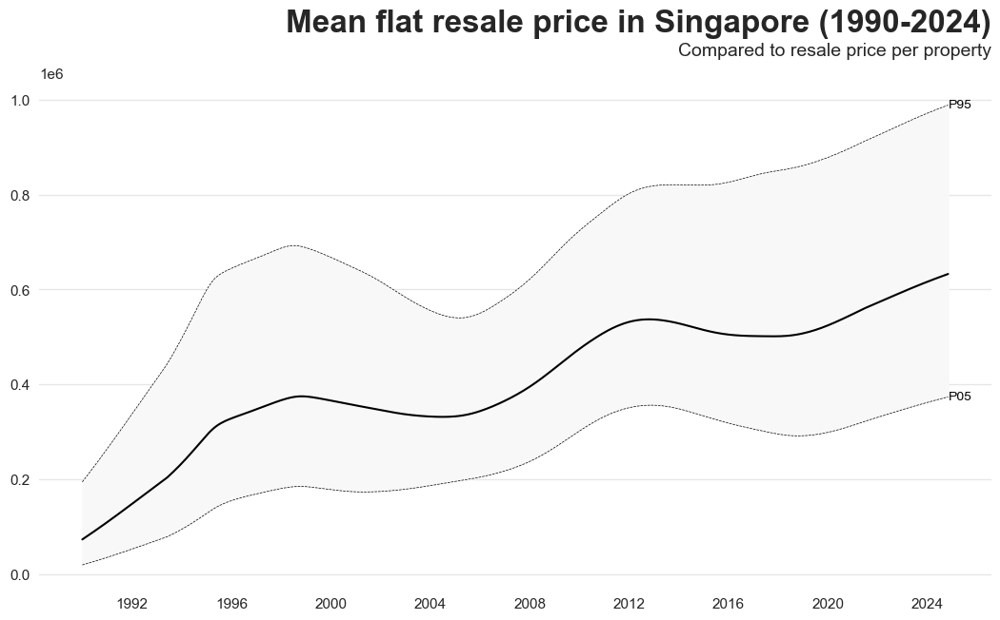

In [51]:
# Group dataframe by dates and calculate the mean, 5th and 95th percentiles of inflation adjusted resale prices
group = df.groupby('date')['infl_adj_price'].agg(
        [
            ('p05', lambda x: np.nanpercentile(x, 5)),
            ('mean', 'mean'),
            ('p95', lambda x: np.nanpercentile(x, 95)),
        ]
    ).reset_index()

for col in ['p05', 'mean', 'p95']:
    smoothed_values = lowess(
        group[col],
        group['date'],
        is_sorted=True,
        frac=.2,
    )

    group[col] = smoothed_values[:, 1]

df_plot = df[['date', 'flat_type', 'infl_adj_price']].copy()
df_plot = pd.merge(df_plot, group, on='date', how='left')

jitter = pd.DataFrame(np.random.randint(30, size=df.size), columns=['jitter'])
df_plot = pd.merge(df_plot, jitter, left_index=True, right_index=True)
df_plot['timedelta'] = [pd.Timedelta(i, unit='d') for i in df_plot['jitter']]
df_plot['jitter_date'] = df_plot['date']+df_plot['timedelta']

df_plot['diff'] = df_plot['infl_adj_price'] - df_plot['mean']

# Plotting

# Set seaborn style to white with horizontal grid lines
sns.set_style("white")

# Define some basic settings for the plot
plt.rcParams["figure.dpi"] = 100
mpl.rcParams["font.family"] = "sans-serif"
mpl.rcParams["axes.labelsize"] = 11
mpl.rcParams["xtick.labelsize"] = 11
mpl.rcParams["ytick.labelsize"] = 11

# Create a new figure and axis
fig, axes = plt.subplots(figsize=(10, 7))

# Add title and subtitle
plt.suptitle(
    "Mean flat resale price in Singapore (1990-2024)",
    fontsize=24,
    fontweight="bold",
    x=1,
    ha="right",
)
plt.title(
    "Compared to resale price per property",
    fontsize=14,
    fontweight="normal",
    x=1,
    ha="right",
    pad=20,
)


# Adjust the margin
fig.subplots_adjust(
    left=0,
    right=1,
    top=0.87,
)

# Remove the borders of the plot
axes.spines["top"].set_visible(False)
axes.spines["bottom"].set_visible(False)
axes.spines["right"].set_visible(False)
axes.spines["left"].set_visible(False)

# Add horizontal grid lines
axes.grid(axis="y", color="0.9", linestyle="-", linewidth=1)

# Plot mean
axes.plot(df_plot['date'], df_plot['mean'], c="k")

# Plot area between p05 and p95
percentiles = ["05", "95"]

axes.fill_between(
    df_plot['date'],
    df_plot[f"p{percentiles[0]}"],
    df_plot[f"p{percentiles[1]}"],
    color="#f8f8f8",
)

# Plot the percentile lines
for percentile in percentiles:
    # Add dashed line for percentile
    axes.plot(
        df_plot['date'],
        df_plot[f"p{percentile}"],
        label=f"{percentile}th Percentile",
        color="black",
        linestyle="dashed",
        linewidth=0.5,
        zorder=9,
    )
    # Place a label on the line
    axes.text(
        df_plot['date'].iloc[-1],
        df_plot[f"p{percentile}"].iloc[-1],
        f"P{percentile}",
        horizontalalignment="left",
        verticalalignment="center",
        color="black",
    )

def get_colorscale_mpl(diff: np.ndarray) -> np.ndarray:
    """
    Calculate colorscale for a given series of values.
    """

    # Create masks for above and below mean
    mask_above = diff > 0
    mask_below = diff < 0

    # Get absolute value of difference
    diff = abs(diff)

    # Create array of zeros with same shape as diff
    diff_norm = np.zeros_like(diff)

    # Calculate min and max for values above the mean and normalize to 0-1
    if len(diff[mask_above]) > 0:
        max_above, min_above = np.nanmax(diff[mask_above]), np.nanmin(diff[mask_above])
        diff_norm[mask_above] = (diff[mask_above] - min_above) / (max_above - min_above)

    # Calculate min and max for values below the mean and normalize to 0-1
    if len(diff[mask_below]) > 0:
        max_below, min_below = np.nanmax(diff[mask_below]), np.nanmin(diff[mask_below])
        diff_norm[mask_below] = (diff[mask_below] - min_below) / (max_below - min_below)

    # Choose a colormap
    colormap_above = plt.get_cmap("YlOrRd")
    colormap_below = plt.get_cmap("YlGnBu")

    # Create an empty array of the length of diff_norm but with 4 channels
    colors = np.zeros((len(diff_norm), 4))

    # Sample colors from colormaps, using normalized values
    colors[mask_above] = colormap_above(diff_norm[mask_above])
    colors[~mask_above] = colormap_below(diff_norm[~mask_above])

    return colors

# Get colorscale using the function defined before
colors = get_colorscale_mpl(df[f"{year}_diff"])

# Set opacity to 0.6 for values between p05 and p95, otherwise 1
opacity = np.where(
    (df[f"{year}"] >= df["p05"]) & (df[f"{year}"] <= df["p95"]), 0.6, 1
)

# Plot the area above and below the mean separately
for method in ["above", "below"]:
    # Create mask to filter for values above mean and reverse for below
    mask = df_plot[f"{year}"] > df[f"mean"]
    if method == "below":
        mask = ~mask

    for i in range(len(data.index) - 1):
        # Get values for current method, leave rest as NaN
        values = np.full(mask.shape, np.nan)
        values[mask] = df[mask][f"{year}"]
        mean = df_plot["mean"].to_numpy()

        # To avoid mix-ups between colorscales, set tomorrow's value to mean
        # if the area switches between above and below the mean
        if (values[i] > mean[i]) ^ (values[i + 1] > mean[i + 1]):
            values[i + 1] = mean[i + 1]

        # Plot area between mean and year's value
        axes.fill_between(
            x=data.index[i : i + 2],
            y1=values[i : i + 2],
            y2=mean[i : i + 2],
            color=colors[i],
            alpha=opacity[i],
            edgecolor="none",
            zorder=8,
        )


plt.autoscale(enable=True, axis="x", tight=True)

plt.show()

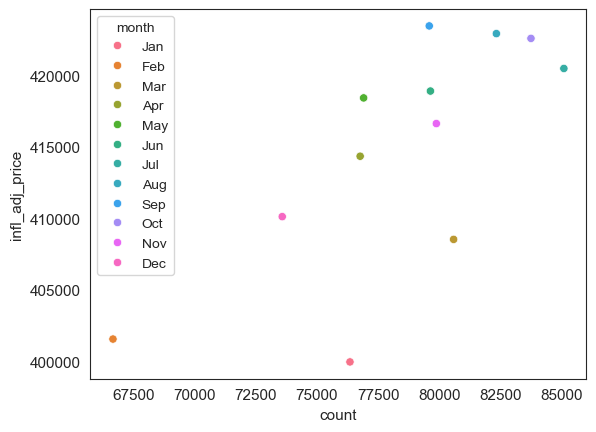

In [21]:
df_plot = df[['month', 'infl_adj_price']].groupby(['month']).mean('infl_adj_price').reset_index()
counts = df.groupby(['month']).size().reset_index(name='count')
df_plot = pd.merge(df_plot, counts, on='month', how='left')

df_plot['month'] = [i for i in ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']]

sns.scatterplot(data=df_plot, x='count', y='infl_adj_price', hue='month')
plt.show()

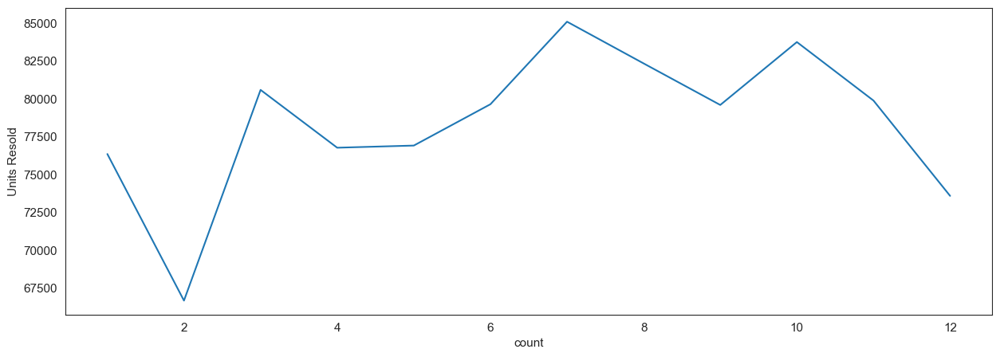

In [22]:
df_plot = df.groupby(['month']).size().reset_index(name='count')

plt.figure(figsize = (15,5))
sns.lineplot(data=df_plot, x='month', y='count')

plt.xlabel('count')
plt.ylabel('Units Resold')
plt.show()

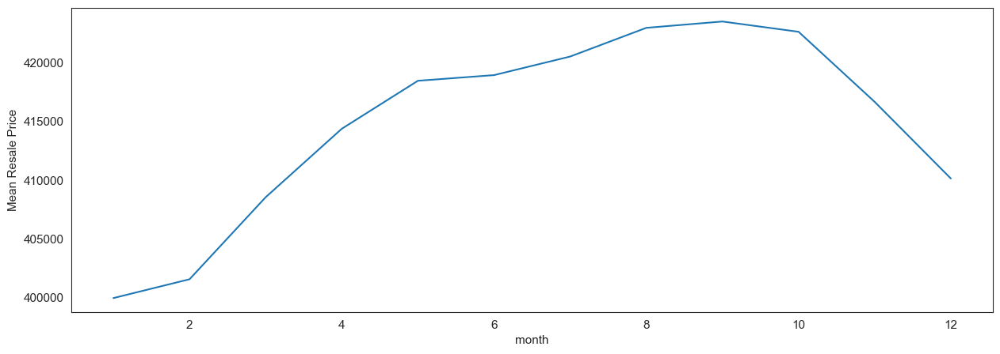

In [23]:
df_plot = df.groupby(['month']).mean('infl_adj_price').reset_index()

plt.figure(figsize = (15,5))
sns.lineplot(data=df_plot, x='month', y='infl_adj_price')

plt.xlabel('month')
plt.ylabel('Mean Resale Price')
plt.show()

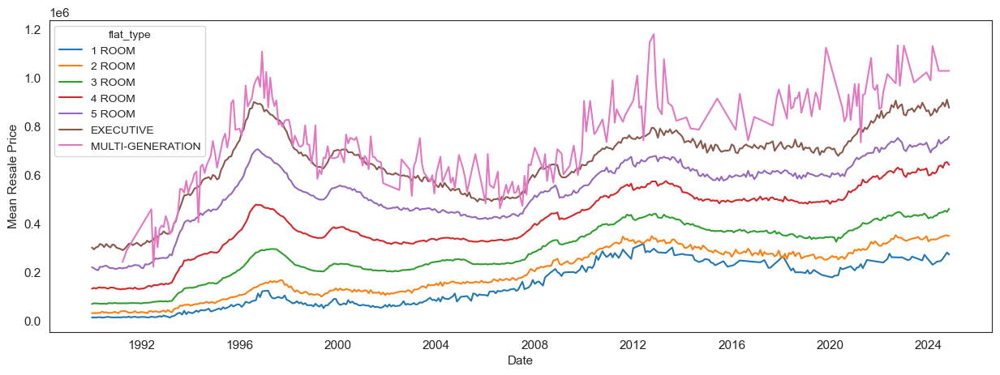

In [24]:
df_plot = df.groupby(['date', 'flat_type']).mean('infl_adj_price').reset_index()

plt.figure(figsize = (15,5))
sns.lineplot(data=df_plot, x='date', y='infl_adj_price', hue='flat_type')

plt.xlabel('Date')
plt.ylabel('Mean Resale Price')
plt.show()

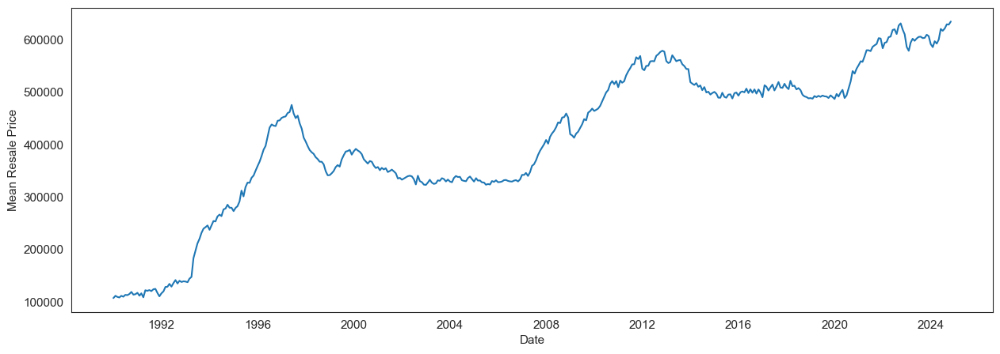

In [25]:
df_plot = df.groupby('date').mean('infl_adj_price').reset_index()

plt.figure(figsize = (15,5))
sns.lineplot(data=df_plot, x='date', y='infl_adj_price')

plt.xlabel('Date')
plt.ylabel('Mean Resale Price')
plt.show()

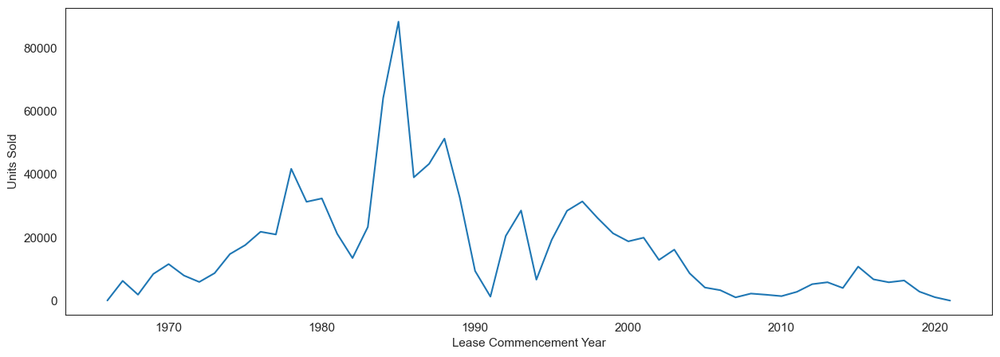

In [26]:
df_plot = pd.DataFrame(df['lease_year'].value_counts(sort=False))

plt.figure(figsize = (15,5))
sns.lineplot(data=df_plot, x='lease_year', y='count')

plt.xlabel('Lease Commencement Year')
plt.ylabel('Units Sold')
plt.show()

In [27]:
df.groupby('years_leased').size().reset_index(name='count')

,years_leased,count
0,-2,4
1,-1,47
2,0,100
3,1,211
4,2,533
...,...,...
56,54,462
57,55,245
58,56,129
59,57,116


Property hold times suggest people cannot flip HDB properties before the 5 year mark. This is confirmed from the HDB website where the HDB stipulates a 5-year minimum occupancy period (MOP) for Unclassified/ Standard flats or flats bought from private property developers under the Design, Build and Sell Scheme (DBSS), and 10-year MOP for Plus and Prime flats.  
Number of units sold tapers off after the 15 year mark. This could either be due to people not wanting to sell homes they have lived for a long time in or due to a housing development boom about 7 to 15 years ago, meaning that the number of units from this period is far greater than earlier periods (i.e. there simply weren't that many HDB apartments 50 years ago).  
If there was a boom in new HDB developments, what could have precipitated it? Perhaps indicatively, an article from Singapore's National Library Board shows that the DBSS was launched in 2005 but was initally met with a slow uptake by property developers who expressed concerns about the unpredictability of the market, the numerous HDB regulations, and the apartment surplus the HDB always seemed to have. While the pilot development was launched in 2006 and opened in 2009, most of the subsequent developments were launched between 2008 and 2011, and opened between 2011 and 2015, adding a total of 8,533 new units. The unpopularity and eventual scrapping of the program suggests that the DBSS is not responsible for the spike.

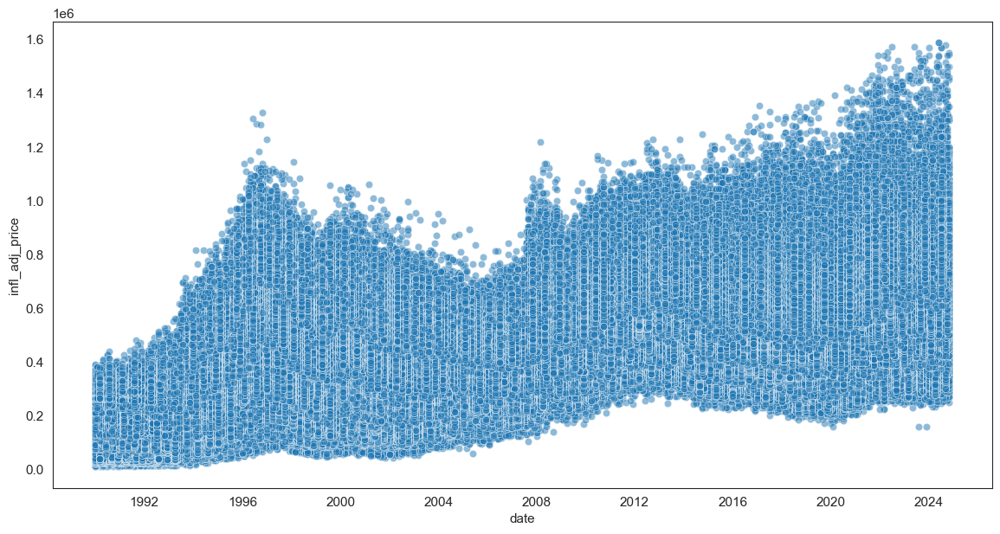

In [28]:
df_plot = df.sort_values(by='flat_type')

plt.figure(figsize = (14,7))
sns.scatterplot(data=df_plot, x='date', y='infl_adj_price', alpha = 0.5)
plt.show()

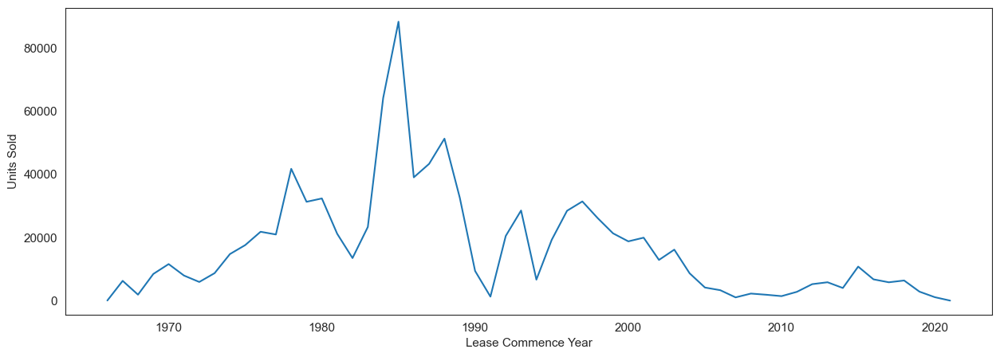

In [29]:
df_plot = pd.DataFrame(df['lease_year'].value_counts(sort=False))

plt.figure(figsize = (15,5))
sns.lineplot(data=df_plot, x='lease_year', y='count')

plt.xlabel('Lease Commence Year')
plt.ylabel('Units Sold')
plt.show()

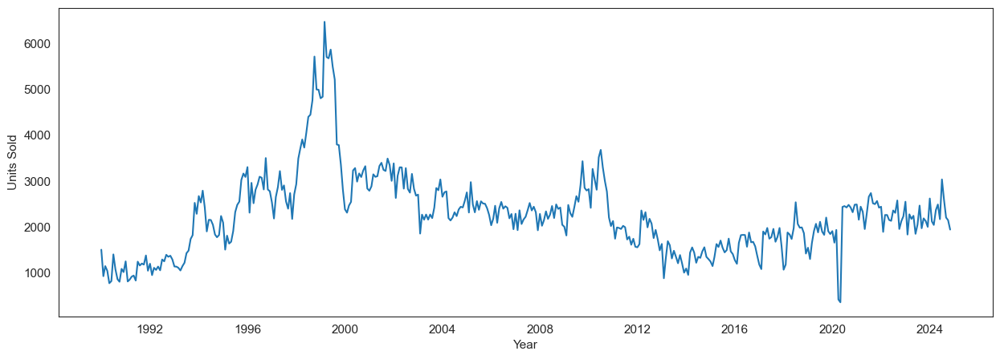

In [30]:
df_plot = pd.DataFrame(df['date'].value_counts(sort=False))

plt.figure(figsize = (15,5))
sns.lineplot(data=df_plot, x='date', y='count')

plt.xlabel('Year')
plt.ylabel('Units Sold')
plt.show()

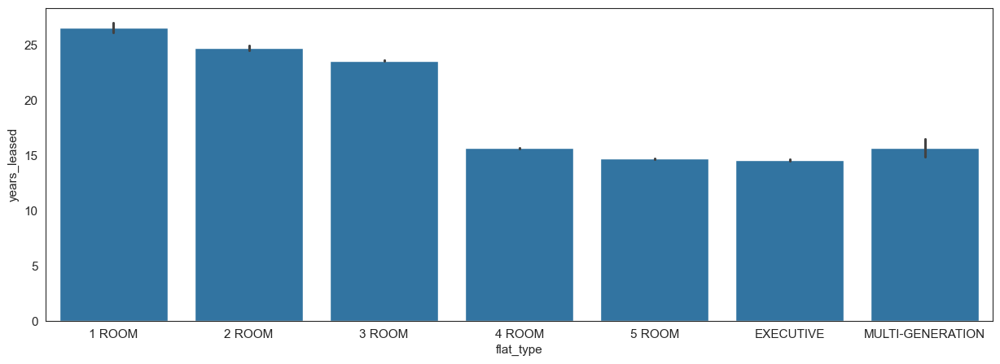

In [31]:
df_plot = df.sort_values('flat_type')

plt.figure(figsize = (15,5))
sns.barplot(data=df_plot, x='flat_type', y='years_leased')
plt.show()

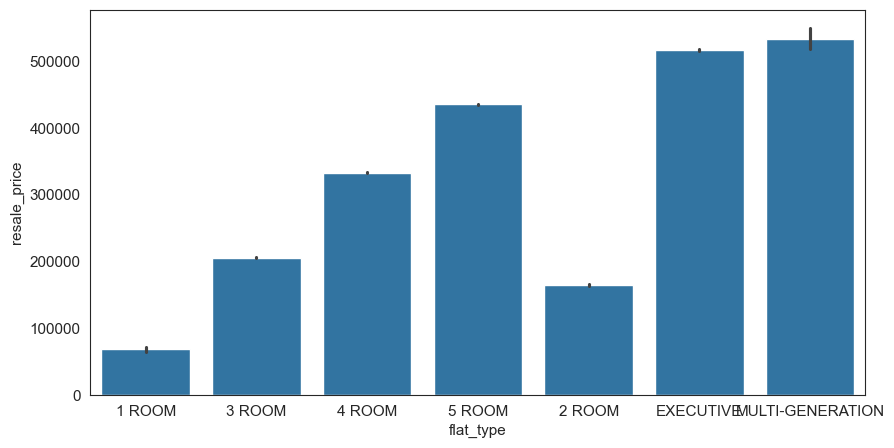

In [32]:
plt.figure(figsize = (10,5))
sns.barplot(data=df, x='flat_type', y='resale_price')
plt.show()

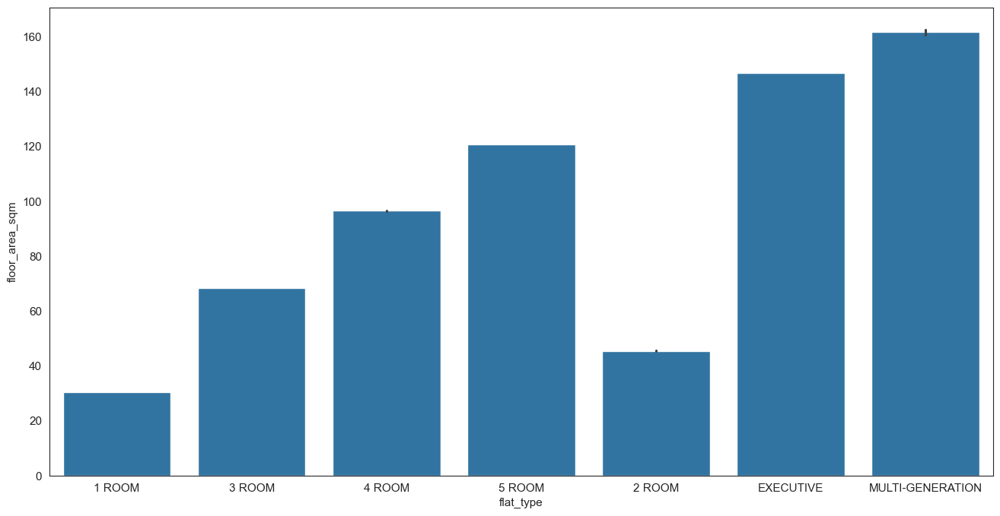

In [33]:
plt.figure(figsize = (16,8))
sns.barplot(data=df, x='flat_type', y='floor_area_sqm')
plt.show()

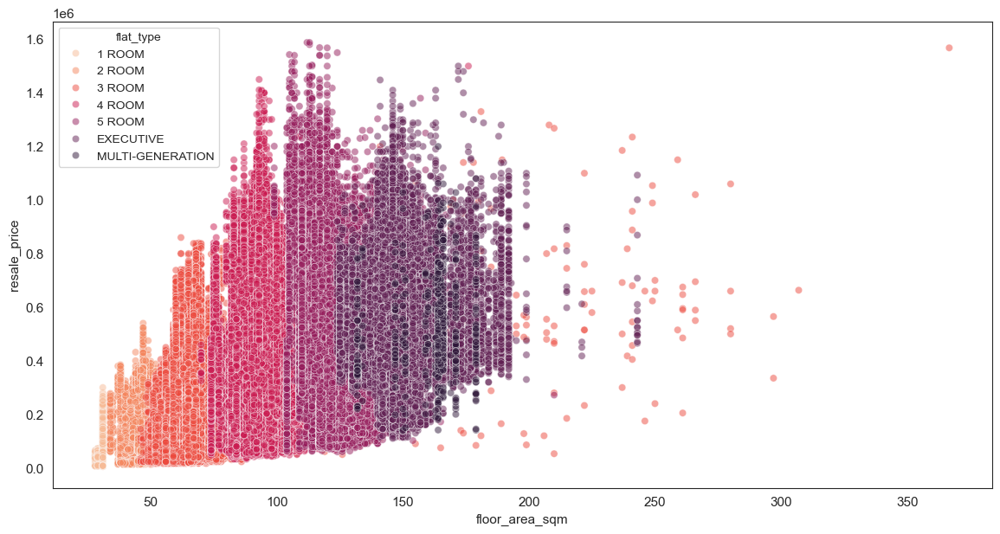

In [34]:
df_plot = df.sort_values(by='flat_type')

plt.figure(figsize = (14,7))
sns.scatterplot(data=df_plot, x='floor_area_sqm', y='resale_price', hue='flat_type', palette='rocket_r', alpha = 0.5)
plt.show()

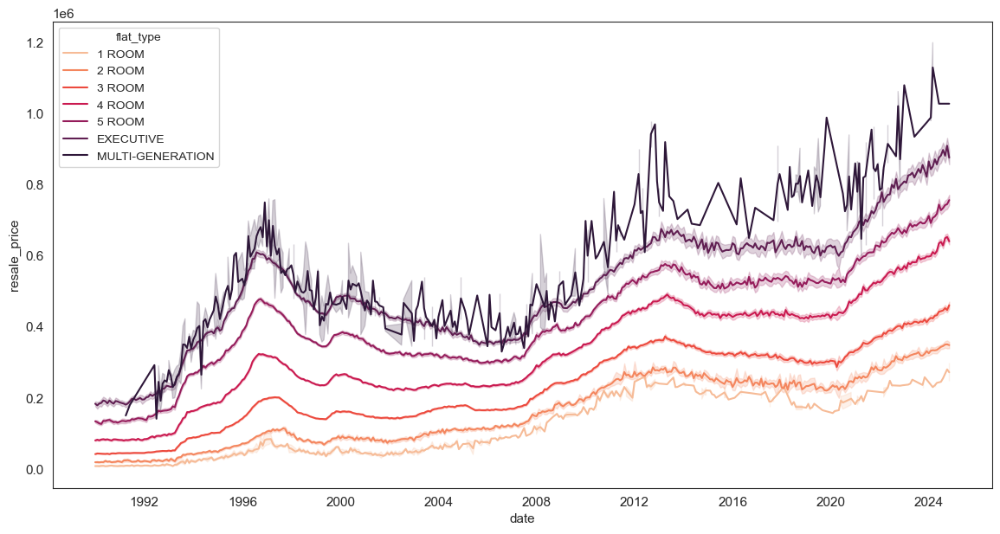

In [35]:
df_plot = df.sort_values(by='flat_type')

plt.figure(figsize = (14,7))
sns.lineplot(data=df_plot, x='date', y='resale_price', hue='flat_type', palette='rocket_r')
plt.show()

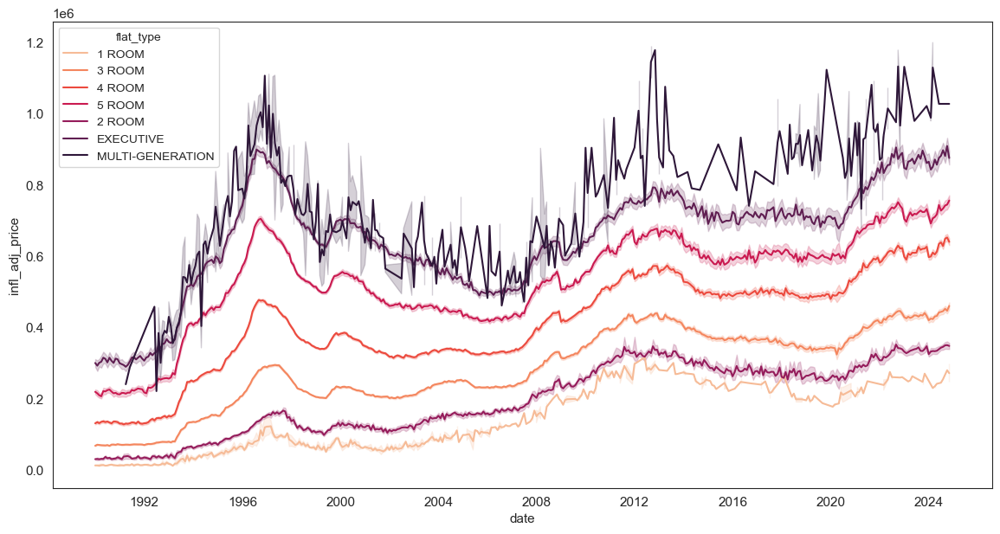

In [36]:
plt.figure(figsize = (14,7))
sns.lineplot(data=df, x='date', y='infl_adj_price', hue='flat_type', palette='rocket_r')
plt.show()

In [37]:
df.groupby('year')['town'].sum().idxmax()

2020

# Average Resale Price

In [38]:
df_avg = df.groupby('date')['infl_adj_price'].mean()
df_avg = pd.DataFrame(df_avg).reset_index()
df_avg

,date,infl_adj_price
0,1990-01-01,106867.795222
1,1990-02-01,111221.765521
2,1990-03-01,109144.491304
3,1990-04-01,108041.172397
4,1990-05-01,111166.174036
...,...,...
414,2024-07-01,616816.872167
415,2024-08-01,621291.916628
416,2024-09-01,629171.304486
417,2024-10-01,628665.175849


<Axes: ylabel='Inflation Adjusted Flat Resale Prices'>

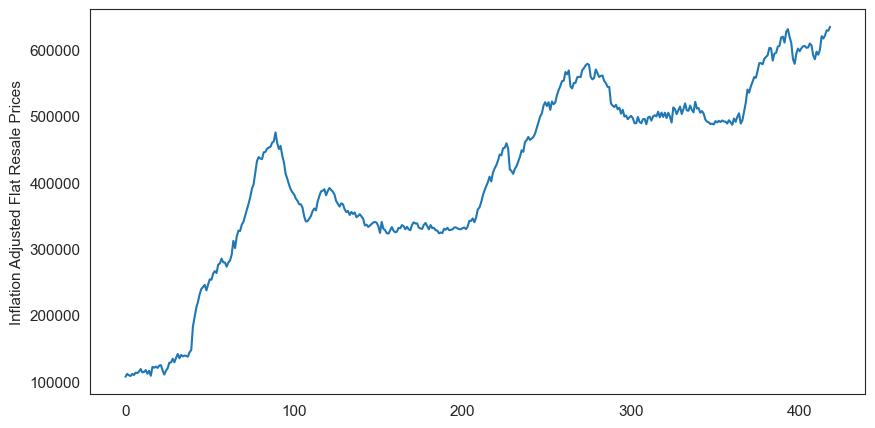

In [39]:
# Setting the text on the Y-axis
plt.ylabel("Inflation Adjusted Flat Resale Prices")

# Setting the size of our graph
df_avg['infl_adj_price'].plot(figsize=(10,5))

In [40]:
df_avg['MA3'] = df_avg['infl_adj_price'].shift(1).rolling(window=3).mean()
df_avg['MA9']= df_avg['infl_adj_price'].shift(1).rolling(window=9).mean()

In [41]:
df_avg.head(20)

,date,infl_adj_price,MA3,MA9
0,1990-01-01,106867.795222,NaN,NaN
1,1990-02-01,111221.765521,NaN,NaN
2,1990-03-01,109144.491304,NaN,NaN
3,1990-04-01,108041.172397,109078.017349,NaN
4,1990-05-01,111166.174036,109469.143074,NaN
5,1990-06-01,109449.506068,109450.612579,NaN
6,1990-07-01,113030.661210,109552.284167,NaN
7,1990-08-01,112426.720686,111215.447105,NaN
8,1990-09-01,114631.024740,111635.629321,NaN
9,1990-10-01,118595.138642,113362.802212,110664.367909


In [42]:
# Dropping the NaN values
df_avg = df_avg.dropna()

# Initialising X and assigning the two feature variables
X = df_avg[['MA3','MA9']]

# Getting the head of the data
X.head()

,MA3,MA9
9,113362.802212,110664.367909
10,115217.628023,111967.406067
11,115537.233543,112207.825148
12,115404.489872,112773.192084
13,114843.051160,113758.708762


In [43]:
# Setting-up the dependent variable
y = df_avg['infl_adj_price']

# Getting the head of the data
y.head()

9     118595.138642
10    113385.537248
11    114232.793725
12    116910.822506
13    111400.737377
Name: infl_adj_price, dtype: float64

In [44]:
# Setting the training set to 80% of the data
training = 0.7
t = int(training*len(df_avg))

# Training dataset
X_train = X[:t]
y_train = y[:t]

# Testing dataset
X_test = X[t:]
y_test = y[t:]

In [45]:
X[:t]

,MA3,MA9
9,113362.802212,110664.367909
10,115217.628023,111967.406067
11,115537.233543,112207.825148
12,115404.489872,112773.192084
13,114843.051160,113758.708762
...,...,...
291,516028.628751,539983.163561
292,515384.180228,535141.024218
293,513487.854581,529479.932491
294,513165.394613,524991.831963


In [46]:
from sklearn.linear_model import LinearRegression

In [47]:
model = LinearRegression().fit(X_train,y_train)

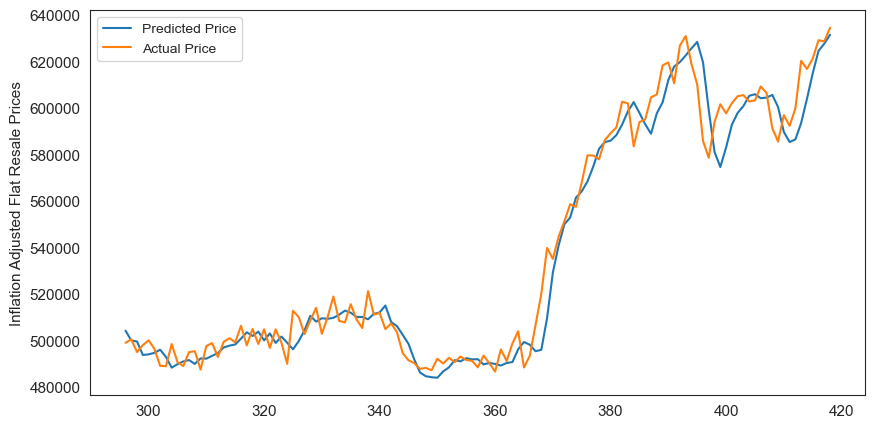

In [48]:
predicted_price = model.predict(X_test)
predicted_price = pd.DataFrame(predicted_price,index=y_test.index,columns = ['price'])
predicted_price.plot(figsize=(10,5))
y_test.plot()
plt.legend(['Predicted Price','Actual Price'])
plt.ylabel("Inflation Adjusted Flat Resale Prices")
plt.show()

In [49]:
# Computing the accuracy of our model
R_squared_score =model.score(X[t:],y[t:])*100
accuracy = ("{0:.2f}".format(R_squared_score))
print ("The model has a " + accuracy + "% accuracy.")
print(f'alpha = {model.intercept_}')
print(f'betas = {model.coef_}')

The model has a 96.68% accuracy.
alpha = 4967.663555760169
betas = [ 1.43312547 -0.44439364]


In [50]:
df.groupby(['date']).mean('infl_adj_price').reset_index()

,date,month,year,floor_area_sqm,lease_year,years_leased,resale_price,infl_adj_price
0,1990-01-01,1.0,1990.0,82.482084,1978.943597,11.056403,65214.120770,106867.795222
1,1990-02-01,2.0,1990.0,84.075618,1979.706767,10.293233,67871.052632,111221.765521
2,1990-03-01,3.0,1990.0,83.761652,1979.503478,10.496522,66603.433913,109144.491304
3,1990-04-01,4.0,1990.0,82.905158,1979.364852,10.635148,65930.152818,108041.172397
4,1990-05-01,5.0,1990.0,83.201157,1979.303342,10.696658,67837.128535,111166.174036
...,...,...,...,...,...,...,...,...
414,2024-07-01,7.0,2024.0,94.839625,1998.595850,25.404150,616816.872161,616816.872167
415,2024-08-01,8.0,2024.0,95.865355,1997.860340,26.139660,621291.916628,621291.916628
416,2024-09-01,9.0,2024.0,95.326371,1998.102401,25.897599,629171.304486,629171.304486
417,2024-10-01,10.0,2024.0,94.906422,1998.075849,25.924151,628665.175840,628665.175849
